https://huggingface.co/facebook/detr-resnet-50

User kernel: Python 3 (ipykernel)

Install in terminal: <br>
pip install transformers<br>
pip install timm

In [3]:
conda env list


# conda environments:
#
base                   /opt/anaconda3
HuggingFaceBook      * /opt/anaconda3/envs/HuggingFaceBook
islp                   /opt/anaconda3/envs/islp
py313                  /opt/anaconda3/envs/py313
python-ds-ml-bootcamp   /opt/anaconda3/envs/python-ds-ml-bootcamp


Note: you may need to restart the kernel to use updated packages.


In [4]:
conda list transformers

# packages in environment at /opt/anaconda3/envs/HuggingFaceBook:
#
# Name                     Version          Build            Channel
transformers               4.55.0           pypi_0           pypi

Note: you may need to restart the kernel to use updated packages.


In [5]:
from transformers import DetrImageProcessor, DetrForObjectDetection
 
image_processor = DetrImageProcessor.from_pretrained(
                      "facebook/detr-resnet-50") 
model = DetrForObjectDetection.from_pretrained(
                      "facebook/detr-resnet-50")

preprocessor_config.json:   0%|          | 0.00/290 [00:00<?, ?B/s]

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/102M [00:00<?, ?B/s]

/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/torch/nn/modules/module.py:2441: UserWarning: for conv1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/torch/nn/modules/module.py:2441: UserWarning: for bn1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/torch/nn/modules/module.py:2441: UserWarning: for bn1.bias: copying from a non-meta parameter in the checkpoint to a 

In [6]:
# what is the model trained to detect?
model.config.id2label

{0: 'N/A',
 1: 'person',
 10: 'traffic light',
 11: 'fire hydrant',
 12: 'street sign',
 13: 'stop sign',
 14: 'parking meter',
 15: 'bench',
 16: 'bird',
 17: 'cat',
 18: 'dog',
 19: 'horse',
 2: 'bicycle',
 20: 'sheep',
 21: 'cow',
 22: 'elephant',
 23: 'bear',
 24: 'zebra',
 25: 'giraffe',
 26: 'hat',
 27: 'backpack',
 28: 'umbrella',
 29: 'shoe',
 3: 'car',
 30: 'eye glasses',
 31: 'handbag',
 32: 'tie',
 33: 'suitcase',
 34: 'frisbee',
 35: 'skis',
 36: 'snowboard',
 37: 'sports ball',
 38: 'kite',
 39: 'baseball bat',
 4: 'motorcycle',
 40: 'baseball glove',
 41: 'skateboard',
 42: 'surfboard',
 43: 'tennis racket',
 44: 'bottle',
 45: 'plate',
 46: 'wine glass',
 47: 'cup',
 48: 'fork',
 49: 'knife',
 5: 'airplane',
 50: 'spoon',
 51: 'bowl',
 52: 'banana',
 53: 'apple',
 54: 'sandwich',
 55: 'orange',
 56: 'broccoli',
 57: 'carrot',
 58: 'hot dog',
 59: 'pizza',
 6: 'bus',
 60: 'donut',
 61: 'cake',
 62: 'chair',
 63: 'couch',
 64: 'potted plant',
 65: 'bed',
 66: 'mirror',
 67

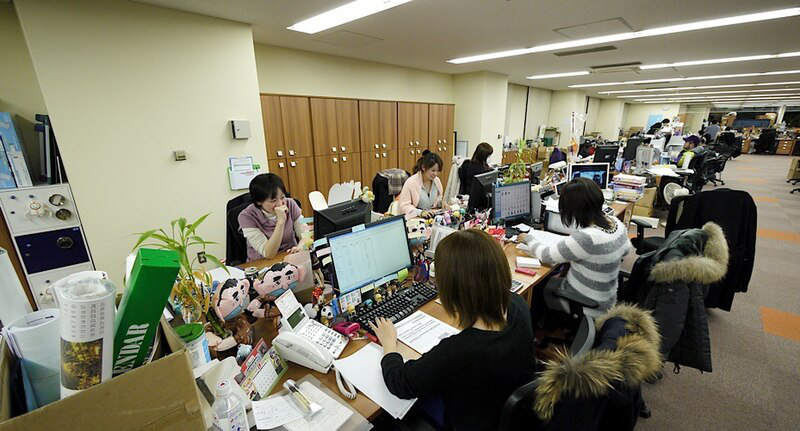

In [8]:
# if necessary: pip install Pillow
from PIL import Image, ImageDraw
import requests
import torch
 
def loadImage(url):
    if url.startswith('http'):
        image = Image.open(requests.get(url, stream=True).raw)
    else:
        image = Image.open(url)
    return image

url = 'https://upload.wikimedia.org/wikipedia/commons/thumb/b/b9/Good_Smile_Company_offices_ladies.jpg/800px-Good_Smile_Company_offices_ladies.jpg?20160911011731'

# image = loadImage('http://bit.ly/46xv3sL') 
image = loadImage(url) 
display(image)

In [9]:
# returns a pytorch tensor
inputs = image_processor(images = image, 
                         return_tensors = "pt")

In [10]:
inputs

{'pixel_values': tensor([[[[-1.1247, -1.1247, -1.1075,  ..., -0.4397, -0.4568, -0.4568],
          [-1.1589, -1.1589, -1.1418,  ..., -0.4397, -0.4397, -0.4397],
          [-1.2103, -1.2103, -1.1932,  ..., -0.4397, -0.4226, -0.4226],
          ...,
          [-0.4226, -0.4568, -0.4911,  ..., -0.5253, -0.5767, -0.6109],
          [-0.3027, -0.3369, -0.3712,  ..., -0.5938, -0.5596, -0.5596],
          [-0.2342, -0.2684, -0.3027,  ..., -0.6281, -0.5596, -0.5253]],

         [[-1.0378, -1.0378, -1.0203,  ..., -0.4251, -0.4426, -0.4426],
          [-1.0728, -1.0728, -1.0553,  ..., -0.4251, -0.4251, -0.4251],
          [-1.1253, -1.1253, -1.1078,  ..., -0.4251, -0.4076, -0.4076],
          ...,
          [-0.5476, -0.5826, -0.6176,  ..., -0.4426, -0.4951, -0.5301],
          [-0.4601, -0.4951, -0.5301,  ..., -0.5126, -0.4776, -0.4776],
          [-0.4076, -0.4426, -0.4776,  ..., -0.5476, -0.4776, -0.4426]],

         [[-1.2990, -1.2990, -1.2816,  ..., -0.4450, -0.4624, -0.4624],
          [-1

In [11]:
outputs = model(**inputs)

In [12]:
# create the target size in the format of (height,width)
target_sizes = torch.tensor([image.size[::-1]])
 
results = image_processor.post_process_object_detection(
              outputs,
              target_sizes = target_sizes, 
              threshold = 0.9)[0]
results

{'scores': tensor([0.9201, 0.9962, 0.9116, 0.9582, 0.9622, 0.9884, 0.9903, 0.9980, 0.9608,
         0.9987, 0.9904, 0.9997, 0.9912, 0.9964], grad_fn=<IndexBackward0>),
 'labels': tensor([ 1, 72, 72,  1,  1,  1, 76,  1, 72,  1, 64,  1, 72,  1]),
 'boxes': tensor([[549.9722, 145.6365, 564.5214, 165.1627],
         [319.5791, 212.7722, 415.1631, 300.4877],
         [468.7404, 168.1221, 498.8426, 208.9651],
         [673.8917, 135.8448, 704.8149, 172.6478],
         [702.8812, 116.0932, 721.5802, 139.6336],
         [455.1605, 142.4424, 497.2042, 205.4877],
         [344.5636, 278.7391, 443.7015, 344.6694],
         [395.2695, 151.8486, 445.8107, 217.0999],
         [310.6425, 193.9883, 374.4872, 236.3351],
         [237.3109, 173.6111, 308.2320, 264.4877],
         [124.8625, 211.0032, 228.8999, 327.3006],
         [367.9193, 226.6947, 535.3132, 427.7357],
         [491.6638, 180.5692, 531.0060, 224.5039],
         [514.1121, 177.0658, 628.9072, 342.3167]], grad_fn=<IndexBackward0>)}

Detected person with confidence 92.01% at [549.97, 145.64, 564.52, 165.16]
Detected tv with confidence 99.62% at [319.58, 212.77, 415.16, 300.49]
Detected tv with confidence 91.16% at [468.74, 168.12, 498.84, 208.97]
Detected person with confidence 95.82% at [673.89, 135.84, 704.81, 172.65]
Detected person with confidence 96.22% at [702.88, 116.09, 721.58, 139.63]
Detected person with confidence 98.84% at [455.16, 142.44, 497.2, 205.49]
Detected keyboard with confidence 99.03% at [344.56, 278.74, 443.7, 344.67]
Detected person with confidence 99.80% at [395.27, 151.85, 445.81, 217.1]
Detected tv with confidence 96.08% at [310.64, 193.99, 374.49, 236.34]
Detected person with confidence 99.87% at [237.31, 173.61, 308.23, 264.49]
Detected potted plant with confidence 99.04% at [124.86, 211.0, 228.9, 327.3]
Detected person with confidence 99.97% at [367.92, 226.69, 535.31, 427.74]
Detected tv with confidence 99.12% at [491.66, 180.57, 531.01, 224.5]
Detected person with confidence 99.64% a

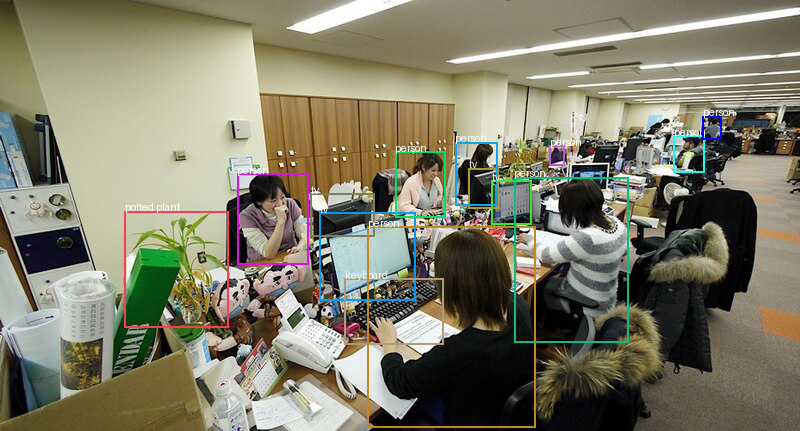

In [13]:

import random
 
draw = ImageDraw.Draw(image)
 
for score, label, box in zip(results["scores"], results["labels"], results["boxes"]):
    box = [round(i, 2) for i in box.tolist()]
    print(
        f"Detected {model.config.id2label[label.item()]} with confidence "       
        f"{(score.item() * 100):.2f}% at {box}"        
    )
        
    r = random.randint(0, 255)
    g = random.randint(0, 255)
    b = random.randint(0, 255)
    color = (r, g, b)
    
    draw.rectangle(box,
                   outline=color,
                   width=2)
    
    draw.text((box[0], box[1]-10),
              model.config.id2label[label.item()],
              fill='white')
    
display(image)

In [14]:
from transformers import pipeline
 
detection = pipeline("object-detection", model="facebook/detr-resnet-50")

Some weights of the model checkpoint at facebook/detr-resnet-50 were not used when initializing DetrForObjectDetection: ['model.backbone.conv_encoder.model.layer1.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer2.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer3.0.downsample.1.num_batches_tracked', 'model.backbone.conv_encoder.model.layer4.0.downsample.1.num_batches_tracked']
- This IS expected if you are initializing DetrForObjectDetection from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing DetrForObjectDetection from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).
Using a slow image processor as `use_fast` is unset and a slow processor was saved w

In [15]:
results = detection(image)
# or results = detection('http://bit.ly/46xv3sL')
results

[{'score': 0.5620276927947998,
  'label': 'tv',
  'box': {'xmin': 548, 'ymin': 144, 'xmax': 565, 'ymax': 165}},
 {'score': 0.5042211413383484,
  'label': 'sports ball',
  'box': {'xmin': 210, 'ymin': 276, 'xmax': 250, 'ymax': 324}},
 {'score': 0.7741919159889221,
  'label': 'bottle',
  'box': {'xmin': 205, 'ymin': 379, 'xmax': 247, 'ymax': 430}},
 {'score': 0.9740164875984192,
  'label': 'person',
  'box': {'xmin': 457, 'ymin': 144, 'xmax': 496, 'ymax': 203}},
 {'score': 0.7910335659980774,
  'label': 'tv',
  'box': {'xmin': 594, 'ymin': 145, 'xmax': 618, 'ymax': 167}},
 {'score': 0.6836382746696472,
  'label': 'tv',
  'box': {'xmin': 468, 'ymin': 170, 'xmax': 493, 'ymax': 206}},
 {'score': 0.9979117512702942,
  'label': 'person',
  'box': {'xmin': 397, 'ymin': 155, 'xmax': 444, 'ymax': 211}},
 {'score': 0.9987664222717285,
  'label': 'person',
  'box': {'xmin': 239, 'ymin': 174, 'xmax': 306, 'ymax': 265}},
 {'score': 0.854465126991272,
  'label': 'tv',
  'box': {'xmin': 701, 'ymin': 1

Detected tv with confidence 56.20% at [548, 144, 565, 165]
Detected sports ball with confidence 50.42% at [210, 276, 250, 324]
Detected bottle with confidence 77.42% at [205, 379, 247, 430]
Detected person with confidence 97.40% at [457, 144, 496, 203]
Detected tv with confidence 79.10% at [594, 145, 618, 167]
Detected tv with confidence 68.36% at [468, 170, 493, 206]
Detected person with confidence 99.79% at [397, 155, 444, 211]
Detected person with confidence 99.88% at [239, 174, 306, 265]
Detected tv with confidence 85.45% at [701, 115, 723, 141]
Detected tv with confidence 96.35% at [226, 175, 308, 269]
Detected person with confidence 51.58% at [650, 116, 672, 133]
Detected potted plant with confidence 90.77% at [129, 213, 227, 364]
Detected chair with confidence 50.48% at [708, 142, 737, 166]
Detected person with confidence 99.95% at [370, 228, 533, 427]
Detected chair with confidence 86.66% at [499, 381, 538, 430]
Detected potted plant with confidence 73.25% at [132, 212, 223, 33

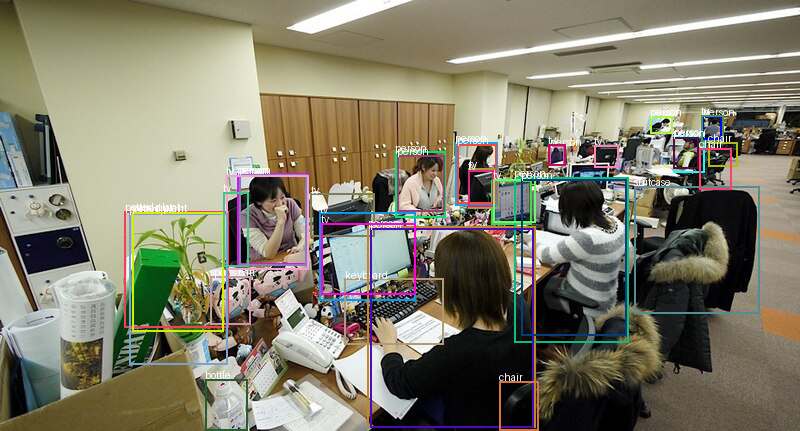

In [16]:

import random
 
draw = ImageDraw.Draw(image)
 
for object in results:
    box = [i for i in object['box'].values()]
    print(
        f"Detected {object['label']} with confidence "       
        f"{(object['score'] * 100):.2f}% at {box}"        
    )
    
    r = random.randint(0, 255)
    g = random.randint(0, 255)
    b = random.randint(0, 255)
    color = (r, g, b)
    
    draw.rectangle(box,
                   outline=color,
                   width=2)
    
    draw.text((box[0], box[1]-10),
              object['label'],
              fill='white')
    
display(image)

In [17]:
detection.model.config.id2label

{0: 'N/A',
 1: 'person',
 10: 'traffic light',
 11: 'fire hydrant',
 12: 'street sign',
 13: 'stop sign',
 14: 'parking meter',
 15: 'bench',
 16: 'bird',
 17: 'cat',
 18: 'dog',
 19: 'horse',
 2: 'bicycle',
 20: 'sheep',
 21: 'cow',
 22: 'elephant',
 23: 'bear',
 24: 'zebra',
 25: 'giraffe',
 26: 'hat',
 27: 'backpack',
 28: 'umbrella',
 29: 'shoe',
 3: 'car',
 30: 'eye glasses',
 31: 'handbag',
 32: 'tie',
 33: 'suitcase',
 34: 'frisbee',
 35: 'skis',
 36: 'snowboard',
 37: 'sports ball',
 38: 'kite',
 39: 'baseball bat',
 4: 'motorcycle',
 40: 'baseball glove',
 41: 'skateboard',
 42: 'surfboard',
 43: 'tennis racket',
 44: 'bottle',
 45: 'plate',
 46: 'wine glass',
 47: 'cup',
 48: 'fork',
 49: 'knife',
 5: 'airplane',
 50: 'spoon',
 51: 'bowl',
 52: 'banana',
 53: 'apple',
 54: 'sandwich',
 55: 'orange',
 56: 'broccoli',
 57: 'carrot',
 58: 'hot dog',
 59: 'pizza',
 6: 'bus',
 60: 'donut',
 61: 'cake',
 62: 'chair',
 63: 'couch',
 64: 'potted plant',
 65: 'bed',
 66: 'mirror',
 67

In [ ]:
# pip install opencv-python
# see object_detection.py example code
# see browser settings for camera access for localhost:8888

In [7]:
from transformers import pipeline
from PIL import Image
import cv2

font   = cv2.FONT_HERSHEY_SIMPLEX
color  = (0, 255, 255)  # BGR for yellow
stroke = 2              # thickness for rectangle

detection = pipeline("object-detection",
                     model="facebook/detr-resnet-50")

stream = cv2.VideoCapture(0)

while(True):
    
    (grabbed, frame) = stream.read()

    image = Image.fromarray(frame)
    results = detection(image)

    for object in results:        
        box = [i for i in object['box'].values()]
       
        cv2.rectangle(frame,
                      (box[0],box[1]),
                      (box[2],box[3]),
                      color, stroke)

        
        cv2.putText(frame, f'({object["label"]})',
                    (box[0],box[1]-8),
                    font, 1, color,
                    stroke, cv2.LINE_AA)
    
    cv2.imshow("Image", frame)
    key = cv2.waitKey(1) & 0xFF    
    if key == ord("q"):
        break

stream.release()
cv2.waitKey(1)
cv2.destroyAllWindows()
cv2.waitKey(1)

/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/torch/nn/modules/module.py:2441: UserWarning: for conv1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/torch/nn/modules/module.py:2441: UserWarning: for bn1.weight: copying from a non-meta parameter in the checkpoint to a meta parameter in the current model, which is a no-op. (Did you mean to pass `assign=True` to assign items in the state dictionary to their corresponding key in the module instead of copying them in place?)
  warnings.warn(
/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/torch/nn/modules/module.py:2441: UserWarning: for bn1.bias: copying from a non-meta parameter in the checkpoint to a 

-1

### Image classification

https://huggingface.co/nateraw/vit-age-classifier

In [14]:
from transformers import pipeline
 
classifier = pipeline("image-classification", 
                       model="nateraw/vit-age-classifier") 
#                      model="ibombonato/vit-age-classifier")  # broken?

config.json:   0%|          | 0.00/850 [00:00<?, ?B/s]

model.safetensors:   0%|          | 0.00/343M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/197 [00:00<?, ?B/s]

Fast image processor class <class 'transformers.models.vit.image_processing_vit_fast.ViTImageProcessorFast'> is available for this model. Using slow image processor class. To use the fast image processor class set `use_fast=True`.
Device set to use mps:0


In [25]:
# image of Barack Obama
output = classifier('https://bit.ly/3PET3TP')
output

[{'label': '40-49', 'score': 0.3235391080379486},
 {'label': '50-59', 'score': 0.266670823097229},
 {'label': '30-39', 'score': 0.2090023010969162},
 {'label': '20-29', 'score': 0.11930886656045914},
 {'label': '60-69', 'score': 0.03441483527421951}]

In [26]:
# image of Barack Obama
output = classifier('images/obama.png')
output

[{'label': '20-29', 'score': 0.2753453552722931},
 {'label': '30-39', 'score': 0.22512374818325043},
 {'label': '40-49', 'score': 0.1289612501859665},
 {'label': '50-59', 'score': 0.11193493008613586},
 {'label': '60-69', 'score': 0.08831586688756943}]

### Image segmentation
https://huggingface.co/nvidia/segformer-b0-finetuned-ade-512-512

In [28]:
from transformers import pipeline
 
segmentation = pipeline("image-segmentation", 
               model="nvidia/segformer-b0-finetuned-ade-512-512")
 
segmentation.model.config.id2label

config.json: 0.00B [00:00, ?B/s]

model.safetensors:   0%|          | 0.00/15.0M [00:00<?, ?B/s]

preprocessor_config.json:   0%|          | 0.00/271 [00:00<?, ?B/s]

/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/transformers/image_processing_base.py:412: UserWarning: The following named arguments are not valid for `SegformerImageProcessor.__init__` and were ignored: 'reduce_labels'
  image_processor = cls(**image_processor_dict)
Device set to use mps:0


{0: 'wall',
 1: 'building',
 2: 'sky',
 3: 'floor',
 4: 'tree',
 5: 'ceiling',
 6: 'road',
 7: 'bed ',
 8: 'windowpane',
 9: 'grass',
 10: 'cabinet',
 11: 'sidewalk',
 12: 'person',
 13: 'earth',
 14: 'door',
 15: 'table',
 16: 'mountain',
 17: 'plant',
 18: 'curtain',
 19: 'chair',
 20: 'car',
 21: 'water',
 22: 'painting',
 23: 'sofa',
 24: 'shelf',
 25: 'house',
 26: 'sea',
 27: 'mirror',
 28: 'rug',
 29: 'field',
 30: 'armchair',
 31: 'seat',
 32: 'fence',
 33: 'desk',
 34: 'rock',
 35: 'wardrobe',
 36: 'lamp',
 37: 'bathtub',
 38: 'railing',
 39: 'cushion',
 40: 'base',
 41: 'box',
 42: 'column',
 43: 'signboard',
 44: 'chest of drawers',
 45: 'counter',
 46: 'sand',
 47: 'sink',
 48: 'skyscraper',
 49: 'fireplace',
 50: 'refrigerator',
 51: 'grandstand',
 52: 'path',
 53: 'stairs',
 54: 'runway',
 55: 'case',
 56: 'pool table',
 57: 'pillow',
 58: 'screen door',
 59: 'stairway',
 60: 'river',
 61: 'bridge',
 62: 'bookcase',
 63: 'blind',
 64: 'coffee table',
 65: 'toilet',
 66: '

<img src='images/plane-wall.png' />

In [29]:
from PIL import Image
import requests
 
url = 'https://bit.ly/46iDeJQ'
results = segmentation(url)
results

[{'score': None,
  'label': 'wall',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'building',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'sky',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'person',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>},
 {'score': None,
  'label': 'airplane',
  'mask': <PIL.Image.Image image mode=L size=1587x2381>}]

wall


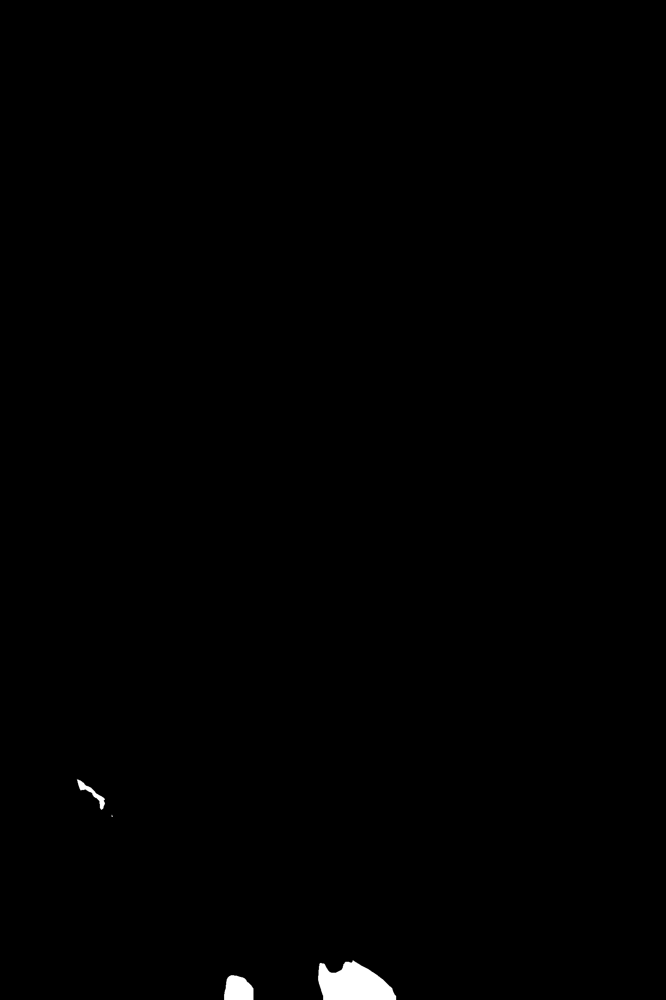

building


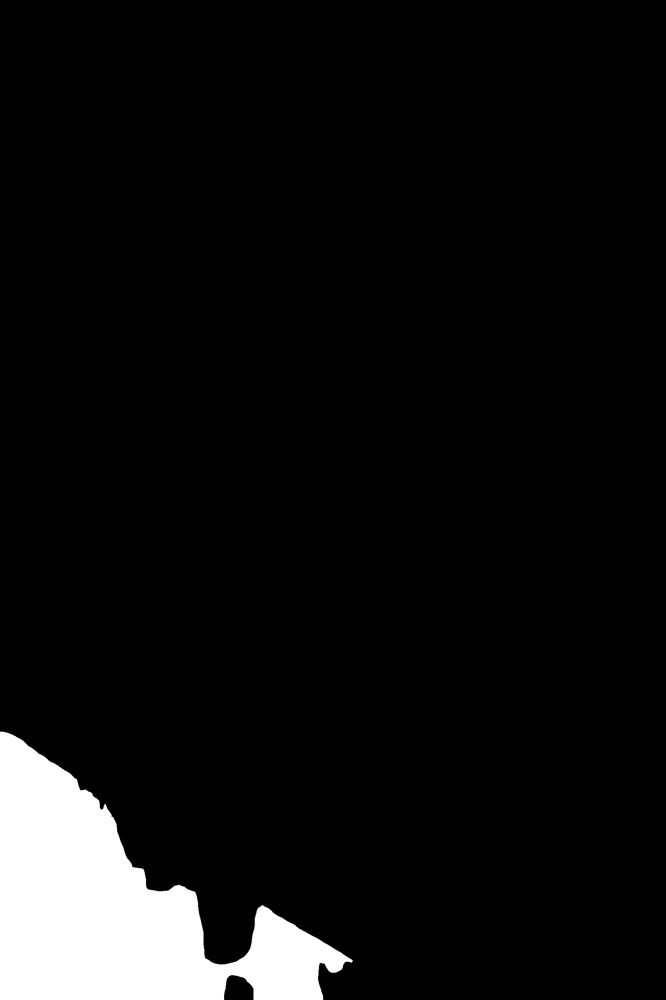

sky


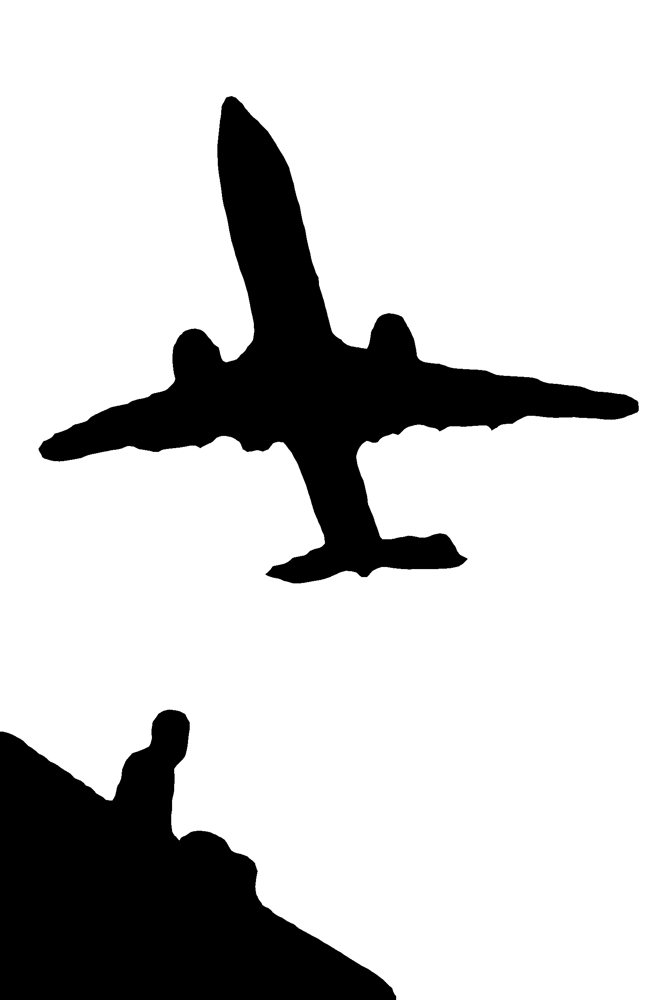

person


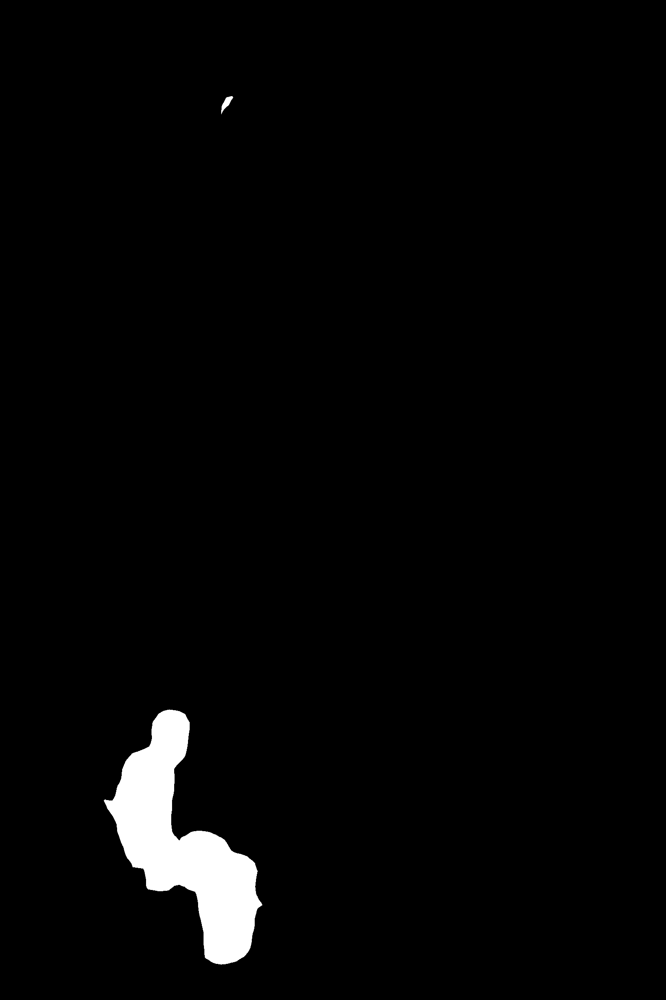

airplane


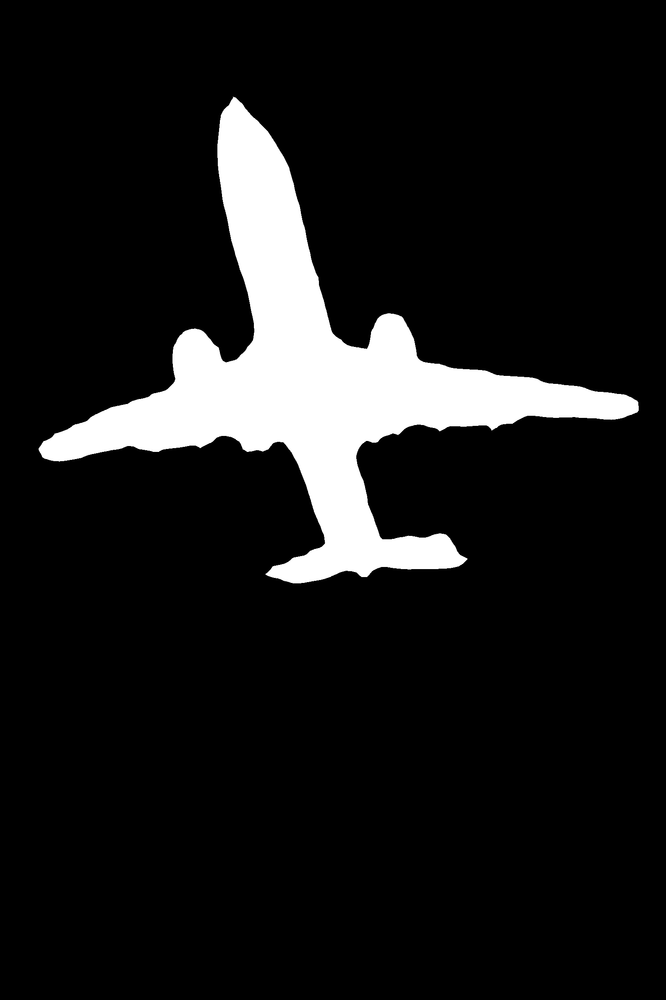

In [30]:
for result in results:
    print(result['label'])
    display(result['mask'])

wall


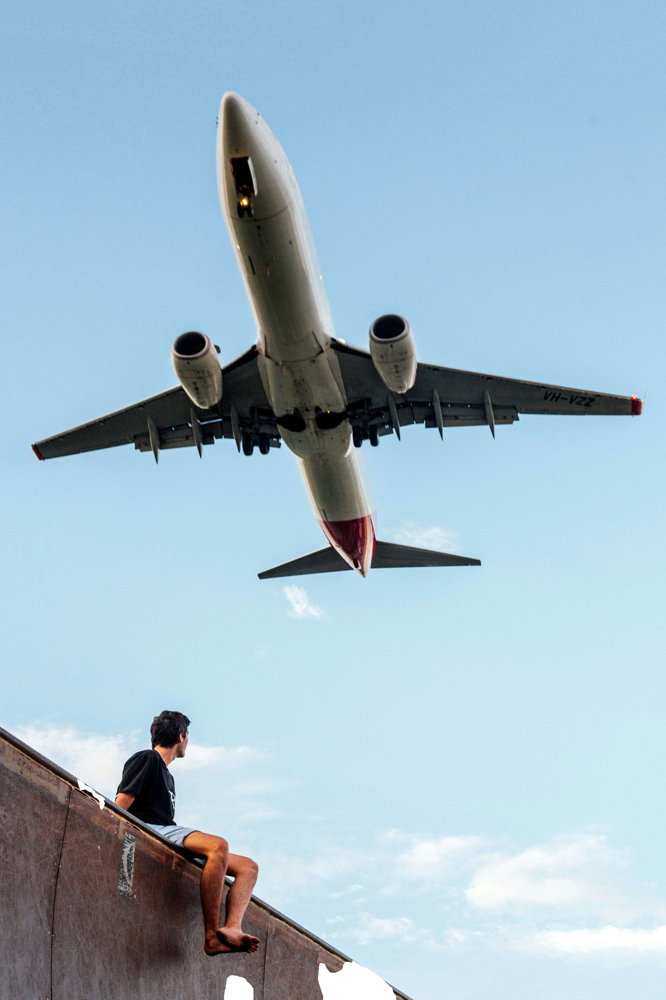

building


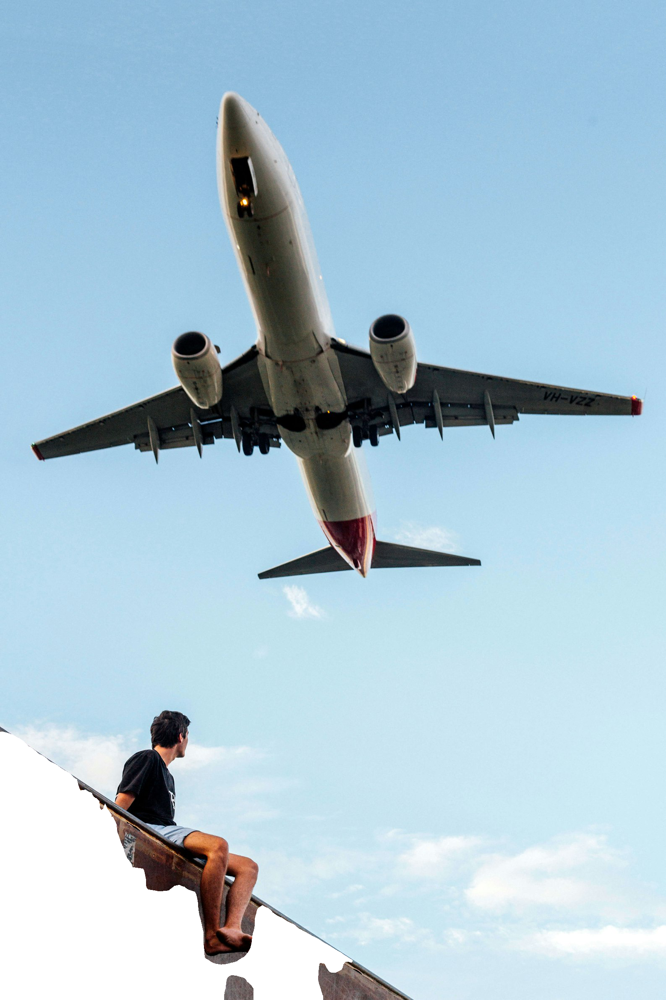

sky


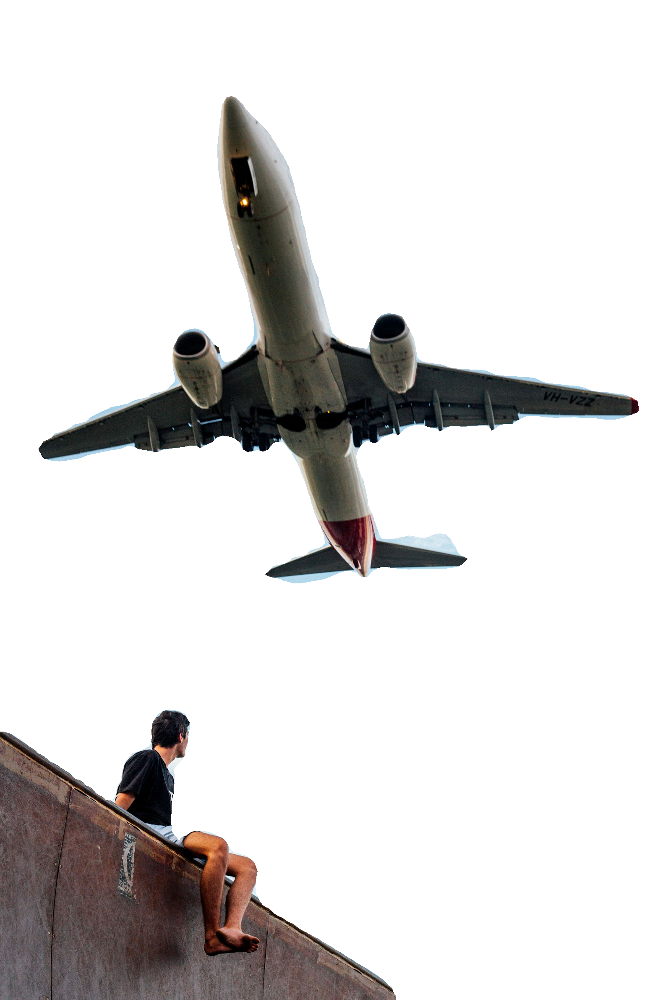

person


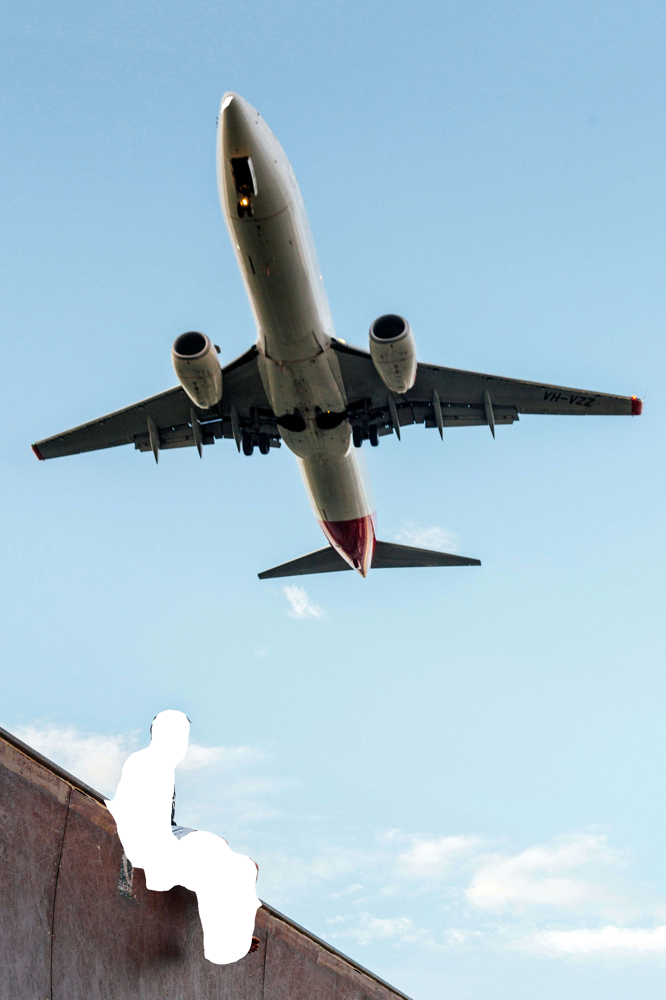

airplane


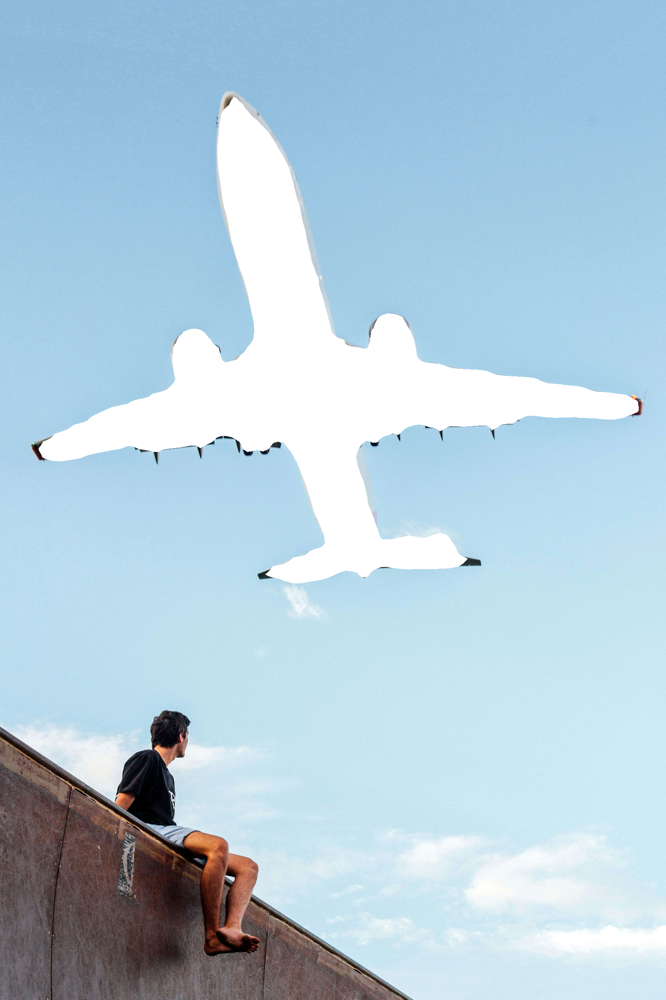

In [31]:
image = Image.open(requests.get(url, stream=True).raw)
 
for result in results:
    base_image = image.copy()
    mask_image = result['mask']
    
    base_image.paste(mask_image, mask=mask_image)
    print(result['label'])
    display(base_image)

wall


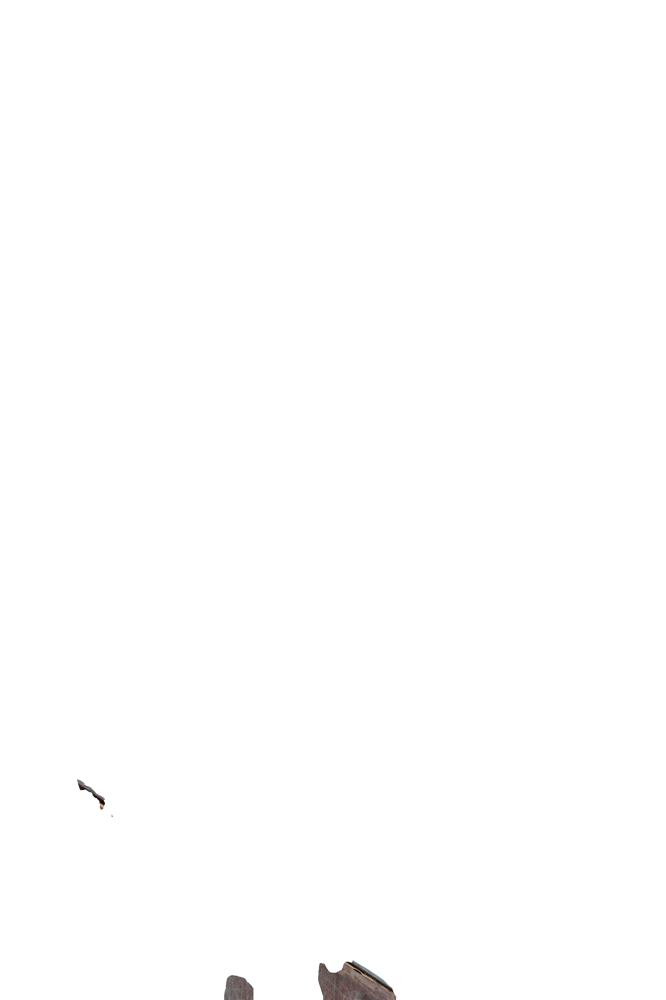

building


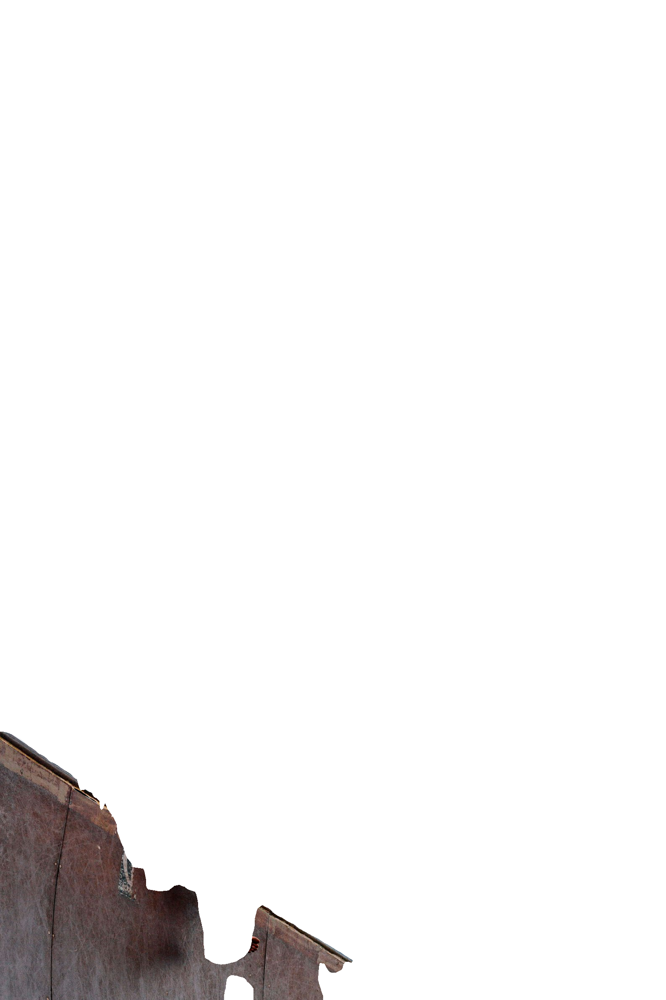

sky


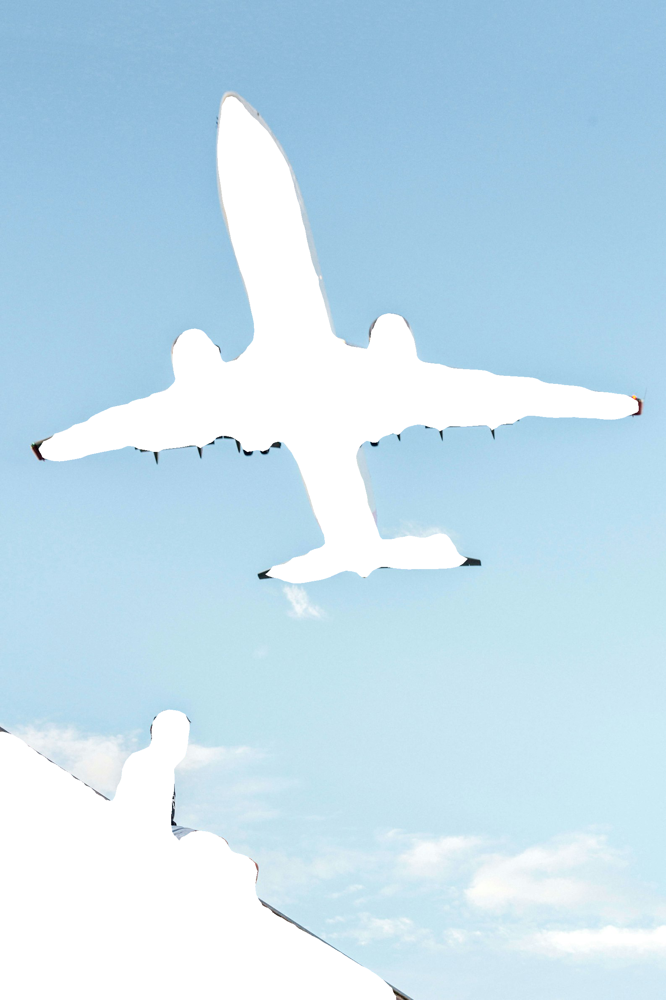

person


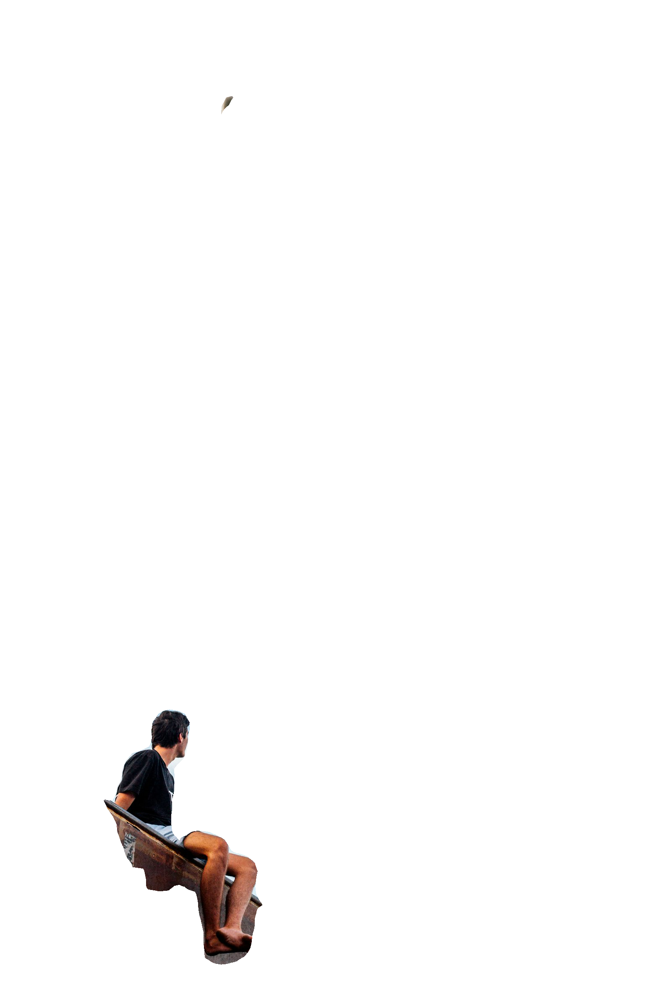

airplane


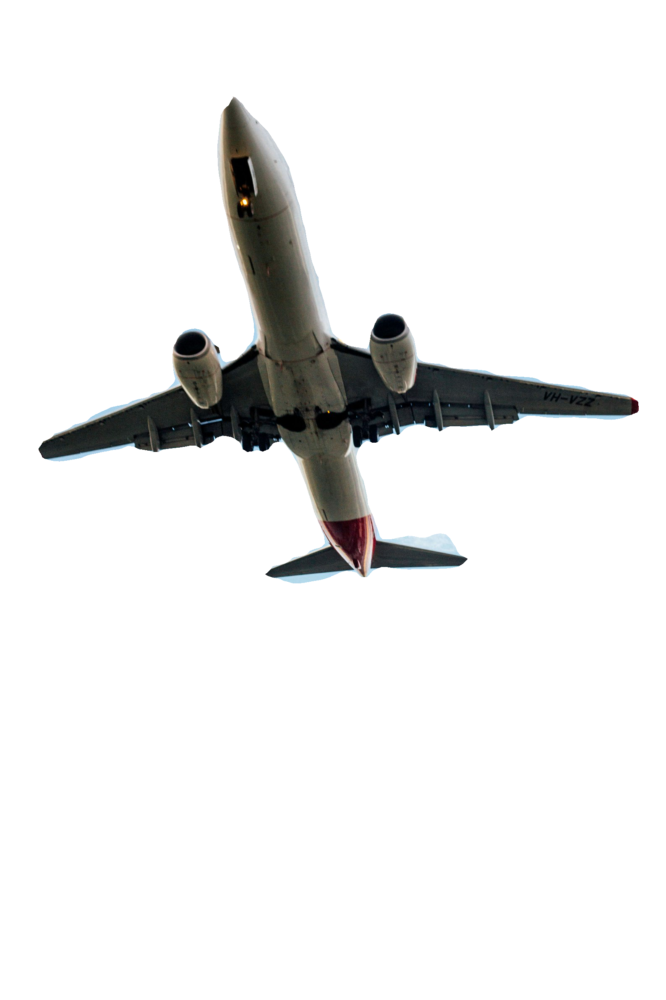

In [32]:
from PIL import ImageOps
 
for result in results:
    base_image = image.copy()
    mask_image = result['mask']
    
    mask_image = ImageOps.invert(mask_image)
    base_image.paste(mask_image, mask=mask_image)
    print(result['label'])
    display(base_image)

### Binding to Gradio

In [1]:
# pip install gradio

In [5]:
from transformers import SegformerForSemanticSegmentation
from transformers import pipeline
 
model = pipeline("image-segmentation",
                 model="nvidia/segformer-b0-finetuned-ade-512-512")
    
def segmentation(image, label):
    image = Image.fromarray(image)
    results = model(image)
    for result in results:
        if result['label'] == label:
            base_image = image.copy()
            mask_image = result['mask']
            mask_image = ImageOps.invert(mask_image)
            base_image.paste(mask_image, mask=mask_image)
            return(base_image)

/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/transformers/image_processing_base.py:412: UserWarning: The following named arguments are not valid for `SegformerImageProcessor.__init__` and were ignored: 'reduce_labels'
  image_processor = cls(**image_processor_dict)
Device set to use mps:0


In [11]:
import gradio as gr
 
# define the input and output fields for Gradio
image_input = gr.Image(label = "Image to segmentize")
 
label = gr.Textbox(label = "Label to look for", placeholder = "Label") 
image_output = gr.Image(label = "Image with the mask applied")
# # bind Gradio to the segmentation() function
gr.Interface(segmentation,
             [image_input, label],
             image_output).launch(share=True)

* Running on local URL:  http://127.0.0.1:7863
* Running on public URL: https://4edb28cebe5c128f35.gradio.live

This share link expires in 1 week. For free permanent hosting and GPU upgrades, run `gradio deploy` from the terminal in the working directory to deploy to Hugging Face Spaces (https://huggingface.co/spaces)


Traceback (most recent call last):
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/queueing.py", line 626, in process_events
    response = await route_utils.call_process_api(
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/route_utils.py", line 350, in call_process_api
    output = await app.get_blocks().process_api(
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/blocks.py", line 2240, in process_api
    result = await self.call_function(
             ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/blocks.py", line 1747, in call_function
    prediction = await anyio.to_thread.run_sync(  # type: ignore
                 ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packag

Created dataset file at: .gradio/flagged/dataset1.csv


Traceback (most recent call last):
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/queueing.py", line 626, in process_events
    response = await route_utils.call_process_api(
               ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/route_utils.py", line 350, in call_process_api
    output = await app.get_blocks().process_api(
             ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/blocks.py", line 2240, in process_api
    result = await self.call_function(
             ^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packages/gradio/blocks.py", line 1747, in call_function
    prediction = await anyio.to_thread.run_sync(  # type: ignore
                 ^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^^
  File "/opt/anaconda3/envs/HuggingFaceBook/lib/python3.11/site-packag

### Video Content Classification

https://huggingface.co/MCG-NJU/videomae-base-short-finetuned-kinetics

In [15]:
pip install eva-decord

Note: you may need to restart the kernel to use updated packages.


In [4]:
pip install av

   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 21.8/21.8 MB 9.6 MB/s eta 0:00:00m eta 0:00:010:01:01
Note: you may need to restart the kernel to use updated packages.


Put video file in webserver folder.
Run: $ cd ~/webserver
$ python -m http.server

In [1]:
from transformers import pipeline
 
video_classifier = pipeline("video-classification", 
                   model="MCG-NJU/videomae-base-short-finetuned-kinetics")

Using a slow image processor as `use_fast` is unset and a slow processor was saved with this model. `use_fast=True` will be the default behavior in v4.52, even if the model was saved with a slow processor. This will result in minor differences in outputs. You'll still be able to use a slow processor with `use_fast=False`.
Device set to use mps:0


In [2]:
# what objects can this model classify?
video_classifier.model.config.id2label

{0: 'abseiling',
 1: 'air drumming',
 2: 'answering questions',
 3: 'applauding',
 4: 'applying cream',
 5: 'archery',
 6: 'arm wrestling',
 7: 'arranging flowers',
 8: 'assembling computer',
 9: 'auctioning',
 10: 'baby waking up',
 11: 'baking cookies',
 12: 'balloon blowing',
 13: 'bandaging',
 14: 'barbequing',
 15: 'bartending',
 16: 'beatboxing',
 17: 'bee keeping',
 18: 'belly dancing',
 19: 'bench pressing',
 20: 'bending back',
 21: 'bending metal',
 22: 'biking through snow',
 23: 'blasting sand',
 24: 'blowing glass',
 25: 'blowing leaves',
 26: 'blowing nose',
 27: 'blowing out candles',
 28: 'bobsledding',
 29: 'bookbinding',
 30: 'bouncing on trampoline',
 31: 'bowling',
 32: 'braiding hair',
 33: 'breading or breadcrumbing',
 34: 'breakdancing',
 35: 'brush painting',
 36: 'brushing hair',
 37: 'brushing teeth',
 38: 'building cabinet',
 39: 'building shed',
 40: 'bungee jumping',
 41: 'busking',
 42: 'canoeing or kayaking',
 43: 'capoeira',
 44: 'carrying baby',
 45: 'c

In [3]:
video_classifier(
    'http://localhost:8000/5621707-hd_1920_1080_24fps.mp4')

[{'score': 0.6638101935386658, 'label': 'spray painting'},
 {'score': 0.054451122879981995, 'label': 'throwing axe'},
 {'score': 0.03350558131933212, 'label': 'blasting sand'},
 {'score': 0.010538680478930473, 'label': 'spraying'},
 {'score': 0.00656494265422225, 'label': 'plastering'}]